# PROJETO3 - Prevendo o Nível de Satisfação dos Clientes do Santander 

**PREMISSAS:** 
1. A satisfação do cliente é uma medida fundamental de sucesso
2. Clientes insatisfeitos cancelam seus serviços e raramente expressam sua insatisfação antes de sair.
3. Clientes satisfeitos, por outro lado, se tornam defensores da marca! 

**PROBLEMA A SER RESOLVIDO:** Identificar clientes insatisfeitos no início do relacionamento.

**OBJETIVO DA SOLUÇÃO:** Servir de  subsídio para que o banco adote medidas proativas para melhorar a felicidade de um cliente antes que seja tarde demais.

**VARIÁVEL A SER PREVISTA:** Variável do conjunto de dados que representa se um cliente está satisfeito ou insatisfeito. No contexto deste problema a variável **TARGET** é  vaariável a ser prevista. Quando esta variável assume o valor 0 quer dizer que o cliente está satisfeito e valor 1 caso contrário.

## 1. Carregar pacotes utilizados

In [1]:
from pyspark.sql import SparkSession, SQLContext
from pyspark.sql.types import FloatType, ArrayType, StringType
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from pyspark.sql import functions as f
from pyspark.ml.feature import StandardScaler, StringIndexer, PCA, OneHotEncoder, VectorAssembler, IndexToString
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.evaluation import MulticlassClassificationEvaluator, BinaryClassificationEvaluator
from pyspark.mllib.evaluation import BinaryClassificationMetrics
from pyspark.ml.linalg import Vectors
from pyspark.sql.functions import udf, col, lit
from pyspark.sql.types import DoubleType, Row
import plotly.offline as py
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator
from pyspark.ml import Pipeline
%matplotlib inline

## 2. Configurar o Spark

In [2]:
# Spark Session - usado para trabalhar com o Spark
spSession = SparkSession.builder.master("local").config("spark.driver.memory", "15g").appName("DSA-SparkSQL").getOrCreate()

In [3]:
#Exibir configurações da Spark Session 
sc._conf.getAll()

[('spark.master', 'local'),
 ('spark.app.name', 'DSA-SparkSQL'),
 ('spark.app.id', 'local-1591323855785'),
 ('spark.sql.catalogImplementation', 'hive'),
 ('spark.rdd.compress', 'True'),
 ('spark.driver.host', 'DESKTOP-T0KP5KD'),
 ('spark.serializer.objectStreamReset', '100'),
 ('spark.driver.memory', '15g'),
 ('spark.executor.id', 'driver'),
 ('spark.driver.port', '50403'),
 ('spark.submit.deployMode', 'client'),
 ('spark.ui.showConsoleProgress', 'true'),
 ('spark.executor.memory', '8gb')]

In [4]:
# Criar o SQL Context para trabalhar com Spark SQL
sqlContext = SQLContext(sc)

## 3. Carregar e exibir informações iniciais sobre os dados

In [5]:
# Ler o arquivo
satisfacaoDF = spSession.read.csv('projeto3_train.csv', header = True)

In [6]:
#Exibir tipo de do objeto carregado pela leitura do arquivo
type(satisfacaoDF)

pyspark.sql.dataframe.DataFrame

In [7]:
# Quantidade de variáveis
len(satisfacaoDF.columns)

371

In [8]:
# Quantidade de amostras
satisfacaoDF.count()

76020

In [9]:
# Exibir Nome das variáveis
with pd.option_context("display.max_rows", len(satisfacaoDF.columns)):
    display(pd.DataFrame(satisfacaoDF.columns, columns=['Variável']))

,Variável
0,ID
1,var3
2,var15
3,imp_ent_var16_ult1
4,imp_op_var39_comer_ult1
5,imp_op_var39_comer_ult3
6,imp_op_var40_comer_ult1
7,imp_op_var40_comer_ult3
8,imp_op_var40_efect_ult1
9,imp_op_var40_efect_ult3


In [10]:
#Converter dados para float
for column in satisfacaoDF.columns:
    satisfacaoDF = satisfacaoDF.withColumn(column, satisfacaoDF[column].cast(FloatType()))

In [11]:
#Obter o resumo estatístico dos dados
columnsToResume = [column for column in satisfacaoDF.columns if column != 'ID']
columnsToResume
with pd.option_context("display.max_columns", len(columnsToResume)):
    summary = satisfacaoDF.select(columnsToResume).describe().toPandas()
    display(summary)

,summary,var3,var15,imp_ent_var16_ult1,imp_op_var39_comer_ult1,imp_op_var39_comer_ult3,imp_op_var40_comer_ult1,imp_op_var40_comer_ult3,imp_op_var40_efect_ult1,imp_op_var40_efect_ult3,imp_op_var40_ult1,imp_op_var41_comer_ult1,imp_op_var41_comer_ult3,imp_op_var41_efect_ult1,imp_op_var41_efect_ult3,imp_op_var41_ult1,imp_op_var39_efect_ult1,imp_op_var39_efect_ult3,imp_op_var39_ult1,imp_sal_var16_ult1,ind_var1_0,ind_var1,ind_var2_0,ind_var2,ind_var5_0,ind_var5,ind_var6_0,ind_var6,ind_var8_0,ind_var8,ind_var12_0,ind_var12,ind_var13_0,ind_var13_corto_0,ind_var13_corto,ind_var13_largo_0,ind_var13_largo,ind_var13_medio_0,ind_var13_medio,ind_var13,ind_var14_0,ind_var14,ind_var17_0,ind_var17,ind_var18_0,ind_var18,ind_var19,ind_var20_0,ind_var20,ind_var24_0,ind_var24,ind_var25_cte,ind_var26_0,ind_var26_cte,ind_var26,ind_var25_0,ind_var25,ind_var27_0,ind_var28_0,ind_var28,ind_var27,ind_var29_0,ind_var29,ind_var30_0,ind_var30,ind_var31_0,ind_var31,ind_var32_cte,ind_var32_0,ind_var32,ind_var33_0,ind_var33,ind_var34_0,ind_var34,ind_var37_cte,ind_var37_0,ind_var37,ind_var39_0,ind_var40_0,ind_var40,ind_var41_0,ind_var41,ind_var39,ind_var44_0,ind_var44,ind_var46_0,ind_var46,num_var1_0,num_var1,num_var4,num_var5_0,num_var5,num_var6_0,num_var6,num_var8_0,num_var8,num_var12_0,num_var12,num_var13_0,num_var13_corto_0,num_var13_corto,num_var13_largo_0,num_var13_largo,num_var13_medio_0,num_var13_medio,num_var13,num_var14_0,num_var14,num_var17_0,num_var17,num_var18_0,num_var18,num_var20_0,num_var20,num_var24_0,num_var24,num_var26_0,num_var26,num_var25_0,num_var25,num_op_var40_hace2,num_op_var40_hace3,num_op_var40_ult1,num_op_var40_ult3,num_op_var41_hace2,num_op_var41_hace3,num_op_var41_ult1,num_op_var41_ult3,num_op_var39_hace2,num_op_var39_hace3,num_op_var39_ult1,num_op_var39_ult3,num_var27_0,num_var28_0,num_var28,num_var27,num_var29_0,num_var29,num_var30_0,num_var30,num_var31_0,num_var31,num_var32_0,num_var32,num_var33_0,num_var33,num_var34_0,num_var34,num_var35,num_var37_med_ult2,num_var37_0,num_var37,num_var39_0,num_var40_0,num_var40,num_var41_0,num_var41,num_var39,num_var42_0,num_var42,num_var44_0,num_var44,num_var46_0,num_var46,saldo_var1,saldo_var5,saldo_var6,saldo_var8,saldo_var12,saldo_var13_corto,saldo_var13_largo,saldo_var13_medio,saldo_var13,saldo_var14,saldo_var17,saldo_var18,saldo_var20,saldo_var24,saldo_var26,saldo_var25,saldo_var28,saldo_var27,saldo_var29,saldo_var30,saldo_var31,...,saldo_var33,saldo_var34,saldo_var37,saldo_var40,saldo_var41,saldo_var42,saldo_var44,saldo_var46,var36,delta_imp_amort_var18_1y3,delta_imp_amort_var34_1y3,delta_imp_aport_var13_1y3,delta_imp_aport_var17_1y3,delta_imp_aport_var33_1y3,delta_imp_compra_var44_1y3,delta_imp_reemb_var13_1y3,delta_imp_reemb_var17_1y3,delta_imp_reemb_var33_1y3,delta_imp_trasp_var17_in_1y3,delta_imp_trasp_var17_out_1y3,delta_imp_trasp_var33_in_1y3,delta_imp_trasp_var33_out_1y3,delta_imp_venta_var44_1y3,delta_num_aport_var13_1y3,delta_num_aport_var17_1y3,delta_num_aport_var33_1y3,delta_num_compra_var44_1y3,delta_num_reemb_var13_1y3,delta_num_reemb_var17_1y3,delta_num_reemb_var33_1y3,delta_num_trasp_var17_in_1y3,delta_num_trasp_var17_out_1y3,delta_num_trasp_var33_in_1y3,delta_num_trasp_var33_out_1y3,delta_num_venta_var44_1y3,imp_amort_var18_hace3,imp_amort_var18_ult1,imp_amort_var34_hace3,imp_amort_var34_ult1,imp_aport_var13_hace3,imp_aport_var13_ult1,imp_aport_var17_hace3,imp_aport_var17_ult1,imp_aport_var33_hace3,imp_aport_var33_ult1,imp_var7_emit_ult1,imp_var7_recib_ult1,imp_compra_var44_hace3,imp_compra_var44_ult1,imp_reemb_var13_hace3,imp_reemb_var13_ult1,imp_reemb_var17_hace3,imp_reemb_var17_ult1,imp_reemb_var33_hace3,imp_reemb_var33_ult1,imp_var43_emit_ult1,imp_trans_var37_ult1,imp_trasp_var17_in_hace3,imp_trasp_var17_in_ult1,imp_trasp_var17_out_hace3,imp_trasp_var17_out_ult1,imp_trasp_var33_in_hace3,imp_trasp_var33_in_ult1,imp_trasp_var33_out_hace3,imp_trasp_var33_out_ult1,imp_venta_var44_hace3,imp_venta_var44_ult1,ind_var7_emit_ult1,ind_var7_recib_ult1,ind_var10_ult1,ind_var10cte

In [12]:
#Quantidade de valores distintos em cada coluna
with pd.option_context("display.max_columns", len(columnsToResume)):
    satisfacaoDF.agg(*(f.countDistinct(col(c)).alias(c) for c in columnsToResume)).toPandas()

Nota-se que as variáveis que possuem o prefixo "ind_", tem sempre dois valores (0 e 1), sendo assim presumimos que todas estas variáveis são categóricas, com duas classes, 0 e 1.

A variável TARGET possui apenas dois valores (0 e 1) e ela é a variável a ser prevista pelo modelo.

As demais variáveis com sufixo ou prefixo aparentam ser numéricas, entretanto, há o caso das variáveis que não possuem prefixo ou sufixo, estas serão alvo de uma investigação mais aprofundada na seção seguinte.

## 4. Análise Exploratória, Feature Engeneering e Feature Selection

In [13]:
# Definir Variáveis preditoras e alvo
targetVar = 'TARGET'
featuresVars = [column for column in columnsToResume if column != targetVar ]

In [14]:
# Armazenar os devios padrão das variáveis
desvios = summary[summary['summary']=='stddev'][featuresVars].iloc[0].to_dict()

### 4.1 Feature Selection - Eliminar Variáveis com Variância Zero e Perto de Zero

In [15]:
# Remover variáveis com desvio padrão zero (não contribuem para o modelo)
featuresVars = [ your_key for your_key in featuresVars if float(desvios[your_key]) !=  0.0]
featuresVars

['var3',
 'var15',
 'imp_ent_var16_ult1',
 'imp_op_var39_comer_ult1',
 'imp_op_var39_comer_ult3',
 'imp_op_var40_comer_ult1',
 'imp_op_var40_comer_ult3',
 'imp_op_var40_efect_ult1',
 'imp_op_var40_efect_ult3',
 'imp_op_var40_ult1',
 'imp_op_var41_comer_ult1',
 'imp_op_var41_comer_ult3',
 'imp_op_var41_efect_ult1',
 'imp_op_var41_efect_ult3',
 'imp_op_var41_ult1',
 'imp_op_var39_efect_ult1',
 'imp_op_var39_efect_ult3',
 'imp_op_var39_ult1',
 'imp_sal_var16_ult1',
 'ind_var1_0',
 'ind_var1',
 'ind_var5_0',
 'ind_var5',
 'ind_var6_0',
 'ind_var6',
 'ind_var8_0',
 'ind_var8',
 'ind_var12_0',
 'ind_var12',
 'ind_var13_0',
 'ind_var13_corto_0',
 'ind_var13_corto',
 'ind_var13_largo_0',
 'ind_var13_largo',
 'ind_var13_medio_0',
 'ind_var13_medio',
 'ind_var13',
 'ind_var14_0',
 'ind_var14',
 'ind_var17_0',
 'ind_var17',
 'ind_var18_0',
 'ind_var18',
 'ind_var19',
 'ind_var20_0',
 'ind_var20',
 'ind_var24_0',
 'ind_var24',
 'ind_var25_cte',
 'ind_var26_0',
 'ind_var26_cte',
 'ind_var26',
 'ind

In [16]:
# Remover variáveis com variáncia quase 0 (contribuem pouco para o modelo)
variancia = {}
for feature in desvios.keys():
    variancia[feature] = float(desvios[feature])*float(desvios[feature])
featuresVars = [ your_key for your_key in featuresVars if float(variancia[your_key]) >=  0.01]

### 4.2 Análise Exploratória e Feature Engeneering - Variáveis Padrão

Após análise do conjunto de dados, notou-se que existem variáveis que não possuem tipo algum de sufixo ou prefixo em seus nomes, denominou-se estas varuáveis de "Variáveis Padrão" e optou-se por realizar uma análise mais profunda de cada uma destas variáveis

In [17]:
# Variáveis "padrão" aquelas que não possuem modificações no nome
defaultVars = [ feature for feature in featuresVars if feature.startswith('var')]
defaultVars

['var3', 'var15', 'var36', 'var21', 'var38']

In [18]:
# Função que faz o "plot" de uma variável qualquer de uma dataframe
def plotSpecificVar(varToPlot,sparkDataFrame,targetVar):
    var = varToPlot
    subplot_titles=('BoxPlot ' + var,
                   'BoxPlot ' + var + " por TARGET",
                   'Histograma '+ var,
                   'Histograma '+ var + " por TARGET 0",
                   'Histograma '+ var + " por TARGET 1")

    data = sparkDataFrame.select(var,targetVar).toPandas()
    dataMain = data[var]
    data0 = data[data[targetVar] == 0.0][var]
    data1 = data[data[targetVar] == 1.0][var]
    target = data[targetVar]
    fig = make_subplots(rows=5, cols=1, subplot_titles= subplot_titles)
    fig.add_trace(go.Box(y=dataMain,quartilemethod="linear"),row=1, col=1)
    fig.add_trace(go.Box(y=dataMain,x=target ,quartilemethod="linear"),row=2, col=1)
    fig.add_trace(go.Histogram(x=dataMain),row=3, col=1)
    fig.add_trace(go.Histogram(x=data0),row=4, col=1)
    fig.add_trace(go.Histogram(x=data1),row=5, col=1)
    fig.update_layout(height=300*5, showlegend=False)
    fig.show()

#### 4.2.1 var3

In [19]:
plotSpecificVar('var3',satisfacaoDF,targetVar)

Verifica-se que a variável possum um outlier de valor '-999999', supoe-se que seja um valor que índique que o campo tem valor nulo. Com este fato em mente, opta-se por preencher os valores nulos com a mediana.

In [20]:
#tratar var3 - retirar valor -999999 que siginifica nulo, substituir pela mediana
def replaceNullWithMedian(value, median):
    if float(value) == float(-999999) : return float(median)
    else : return float(value)


In [21]:
#Calcular mediana e aplicar a função que substitui o valor nulo, criando nova variável "var3_transform"
median = satisfacaoDF.approxQuantile("var3", [0.5], 0.01)[0]
udfReplaceNullWithMedian = udf(lambda x: replaceNullWithMedian(x,median), FloatType())
satisfacaoDF = satisfacaoDF.withColumn("var3_transform", udfReplaceNullWithMedian(col("var3")))

#### 4.2.2 var36

In [22]:
plotSpecificVar('var36',satisfacaoDF,targetVar)

#### 4.2.3 var21

In [23]:
plotSpecificVar('var21',satisfacaoDF,targetVar)

#### 4.2.4 var38

In [24]:
plotSpecificVar('var38',satisfacaoDF,targetVar)

#### 4.2.5 var15

In [25]:
plotSpecificVar('var15',satisfacaoDF,targetVar)

A variável 'var15' tem uma distribuição que se assemelha a uma distribuição de idades, variando de zero a aproximadamente 120, este fato orientou a divisão da variável em 6 faixas: menores que 18, 18-29, 30-39,40-59, 60-79, maiores de 80 

In [26]:
#Tratar a variável var15, dividindo em buckets

from pyspark.ml.feature import Bucketizer
from pyspark.sql.functions import array, col, lit
splits = [-float("inf"), 18,30,40,60,80, float("inf")]
bucketizer = Bucketizer(
    splits=splits, inputCol="var15", outputCol="var15_transform"
)
satisfacaoDF = bucketizer.transform(satisfacaoDF)


#### 4.2.6 Classificar variáveis Padrão em Numéricas e Categóricas

Após análise dos gráficos de cada uma das variáveis padrão, concluiu-se que elas estão divididas em numéricas e categóricas.
Sendo as numéricas "var21","var38" e "var3" que após sofrer transformação assumiu o nome de "var3_transform" e as categóricas "var36" e "var15" que após sofrer transformação assumiu o nome de "var15_transform"

In [27]:
#Classificar defaultVars em categóricas e numéricas
defaultVarsCat = ["var15_transform","var36"]
defaultVarsNum = ["var3_transform","var21","var38"]

### 4.3 Feature Selection - Variáveis Numéricas e Categóricas

In [28]:
#Distribuir as variáveis entre numéricas e categóricas
cathegoricalVars = [ feature for feature in set(featuresVars + defaultVarsCat) if (feature.startswith('ind')) or feature in defaultVarsCat]
numericVars = [ feature for feature in set(featuresVars + defaultVarsNum) if ((feature not in cathegoricalVars) and (feature not in defaultVars)) or feature in defaultVarsNum ]

In [29]:
#Número de variáveis após a limpeza
varsAfterClean =  list(cathegoricalVars) + list(numericVars) + [targetVar]
print("Quantidade de Variáveis Após Limpeza: "+str(len(varsAfterClean)))

Quantidade de Variáveis Após Limpeza: 273


### 4.4 Salvar e Carregar dataframe Intermediário

In [30]:
%%capture
satisfacaoDF.select(varsAfterClean).coalesce(1).write.option("header","true").option("sep",",").mode("overwrite").parquet("satisfacaoDF_standart")
satisfacaoDF.unpersist()

In [31]:
%%capture
satisfacaoDF = spSession.read.parquet('satisfacaoDF_standart')
satisfacaoDF.cache()

###  4.5. Análise Exploratória - Variável TARGET (A ser prevista)

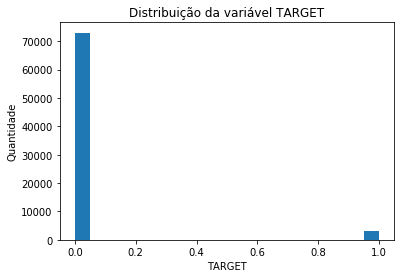

In [32]:
#checar a distribuição da variável "TARGET", que é a que será prevista
bins, counts = satisfacaoDF.select(targetVar).rdd.flatMap(lambda x: x).histogram(20)
plt.hist(bins[:-1], bins=bins, weights=counts, label = column)
plt.title("Distribuição da variável TARGET")
plt.xlabel("TARGET")
plt.ylabel("Quantidade")
plt.show()


Verifica-se que a distribuição da variável target é altamente desbalanceada, isto pode prejudicar o desempenho do modelo caso o desbalanceamento não seja levado em consideração.

### 4.6 Valores nulos no dataframe

In [33]:
# checar se existem valores nulos ou nill no dataframe
expression = lambda c : f.count(f.when(f.isnull(c), c).otherwise(f.when(f.isnan(c), c))).alias(c) 
nullValuesDF = satisfacaoDF.select([expression(c) for c in satisfacaoDF.columns]).toPandas().T[0]
nullValuesDF = nullValuesDF.loc[lambda s: s > 0].to_frame()
nullValuesDF.columns = ['Quantidade']
if len(nullValuesDF) == 0:
    print("Não existem valores nullos no dataframe")
else:
    nullValuesDF

Não existem valores nullos no dataframe


## 5. Feature Engeneering - Variáveis Categóricas

In [34]:
%%capture
# Dividir em Dados de Treino e de Teste
(dados_treino, dados_teste) = satisfacaoDF.randomSplit([0.8, 0.2])
dados_treino.cache()
dados_teste.cache()

### 5.1 Contagem do Nº de Ocorrências

In [35]:
#Adicionar a contagem da ocorrência de cada variável categórica nos dados de treino

dados_treino.registerTempTable('table')

sql =  'SELECT *,'

counts = []
for cathegory in cathegoricalVars:
    counts.append('COUNT(*) OVER (PARTITION BY '+cathegory +') AS '+cathegory+'_count ')
countStmt = ','.join(counts)  

sql = sql + countStmt + ' FROM table'

dados_treino = sqlContext.sql(sql)

In [36]:
#Adicionar a contagem da ocorrência de cada variável categórica nos dados de teste
dados_teste.registerTempTable('table')
contagem_teste = sqlContext.sql(sql)

In [37]:
# Armazenar as variáveis de contagem recem criadas
countVars = [ feature for feature in set(dados_treino.columns) if feature.endswith('_count')]

In [38]:
# Dicionários que armazenam o valor de contagem de cada classe de cada uma das variáveis categóricas, para dados de treino e de teste
countDictTreino = {}
countDictTeste = {}
for i in cathegoricalVars:
    def getTempDict(tempDict,i):
        return dict([(tempDict[i][key], tempDict[i+'_count'][key]) for key in tempDict[i]])
    
    tempDict = dados_treino.select(i,i+'_count').distinct().toPandas().to_dict()
    countDictTreino[i] = getTempDict(tempDict,i)
    tempDict = contagem_teste.select(i,i+'_count').distinct().toPandas().to_dict()
    countDictTeste[i] = getTempDict(tempDict,i)
    

In [39]:
#Mesclar contagem de dados de treino e de teste
countDict = {}
for i in cathegoricalVars:
    countDict[i] = {}
    for j in set(list(countDictTreino[i].keys()) + list(countDictTeste[i].keys())):
        countDict[i][j]=countDictTreino[i][j] + countDictTeste[i][j]
    

In [40]:
# aplicar contagens aos dados de teste
for i in cathegoricalVars:
    udfFunc = udf(lambda x: float(countDict[i][x]) , FloatType())
    dados_teste = dados_teste.withColumn(i+"_count",udfFunc(f.col(i)))

### 5.2 Indexação e OneHotEncoding

In [41]:
#String index variaveis categoricas
indexers = [StringIndexer(inputCol=column, outputCol=column+"_index").fit(dados_treino) for column in list(set(cathegoricalVars)) ]
pipeline = Pipeline(stages=indexers)
pipeline = pipeline.fit(dados_treino)
dados_treino = pipeline.transform(dados_treino)
dados_teste = pipeline.transform(dados_teste)

In [42]:
#OneHotEncoding variáveis categoricas
oneHoters = [OneHotEncoder(dropLast=False, inputCol=column, outputCol=column+"_onehot") for column in list(set([column for column in dados_treino.columns if column.endswith("_index")])) ]
pipeline = Pipeline(stages=oneHoters)
pipeline = pipeline.fit(dados_treino)
dados_treino = pipeline.transform(dados_treino)
dados_teste = pipeline.transform(dados_teste)

In [43]:
#Combinar variáveis geradas pela etapa anterior em um único vetor
vecAssembler = VectorAssembler(inputCols=list(set([column for column in dados_treino.columns if column.endswith("_onehot")])), outputCol="catFeatures")
dados_treino = vecAssembler.transform(dados_treino)
dados_teste = vecAssembler.transform(dados_teste)

In [44]:
#selecionar apenas as variáveis necessárias à realização das próximas etapas do algoritmo
dados_treino = dados_treino.select(numericVars + ["catFeatures"] + countVars + [targetVar])
dados_teste = dados_teste.select(numericVars + ["catFeatures"] + countVars+ [targetVar])

In [45]:
%%capture
# salvar dataset de treino e de teste, já com as variáveis selecionadas e transformadas
dados_treino.coalesce(1).write.option("header","true").option("sep",",").mode("overwrite").parquet("dados_treino_selected_transformed")
dados_teste.coalesce(1).write.option("header","true").option("sep",",").mode("overwrite").parquet("dados_treino_selected_transformed")
dados_treino.unpersist()

In [46]:
%%capture
# Carregar dados de treino e de teste já com as variáveis selecionadas e transformadas
dados_treino = spSession.read.parquet('dados_treino_selected_transformed')
dados_teste = spSession.read.parquet('dados_treino_selected_transformed')
dados_treino.cache()
dados_teste.cache()

## 6. Feature Engeneering - Variáveis Numéricas

In [47]:
# calcular o percentil 0.5(mediana) e o pecentil 0.99
percentils = {}
for var in numericVars:
    percentils[var] = dados_treino.stat.approxQuantile(var,[0.5,0.99],0.0)

In [48]:
# Substituir os outliers (acima do percentil 0.99), pela mediana
for var in numericVars:
    percentil = percentils[var][1]
    median = percentils[var][0]
    def replaceOutlierWithMean(value, targetValue, percentil, median):
        if (targetValue == 0.0) and (float(value) > float(percentil)) : return float(median)
        else : return float(value)
    udfReplaceOutlierWithMean = udf(lambda x: replaceOutlierWithMean(x[0],x[1],percentil,median), FloatType())
    dados_treino = dados_treino.withColumn(var, udfReplaceOutlierWithMean(f.struct(var, targetVar)))
    dados_teste = dados_teste.withColumn(var, udfReplaceOutlierWithMean(f.struct(var, targetVar)))

## 7. Formatar Dataframe Para Aplicação do Algoritmo de PCA

In [49]:
#Adicionar coluna de taxa de balanceamento que será utilizada para dar peso as classes quando aplicado o algoritmo de regressão logistica
numNegatives = dados_treino.filter(dados_treino[targetVar] == 0.0).count()
datasetSize = dados_treino.count()
balancingRatio = float(datasetSize - numNegatives) / datasetSize

def calculateWeights(data, balancingRatio):
    if data == 0.0:
        return 1 * balancingRatio
    else:
        return (1 * (1.0 - balancingRatio))

def transformRDD(row, numericVars,countVars, catFeaturesVar, targetVar, balancingRatio) :
    
    numericDict =  { your_key: row.asDict()[your_key] for your_key in numericVars }
    
    countDict =  { your_key: row.asDict()[your_key] for your_key in countVars }
    
    cathegoricalValues = row[catFeaturesVar]
    
    numericFeaturesValues = []
    
    countFeaturesValues = []
    
 
    for feature in numericVars:
        numericFeaturesValues.append(float(numericDict[feature]))
        
    for feature in countVars:
        countFeaturesValues.append(float(countDict[feature]))
    result = []
    obj = [numericFeaturesValues] +[countFeaturesValues] + [row[targetVar]] + [calculateWeights(row[targetVar], balancingRatio)] + [[float(i) for i in cathegoricalValues.values]]
    return obj



In [50]:
%%capture
# coletar todas as variáveis necessárias para realizar o treinamento do modelo e aplicação do PCA
dados_treino = dados_treino.rdd
dados_treino.cache()
dados_treino = dados_treino.map(lambda j: transformRDD(j,numericVars, countVars,'catFeatures', targetVar,balancingRatio))

In [51]:
%%capture
# coletar todas as variáveis necessárias para realizar o teste do modelo e aplicação do PCA
dados_teste = dados_teste.rdd
dados_teste.cache()
dados_teste = dados_teste.map(lambda j: transformRDD(j,numericVars, countVars,'catFeatures', targetVar,balancingRatio))

In [52]:
#criar dataframes de treino e de teste, a partir dos rdd criados e mapeados na etapa anterior, denominando corretamente cada coluna de atributos
satiscacaoVars = ['numericFeatures','countFeatures',targetVar,'balancingRatio','catFeatures']
dados_teste = spSession.createDataFrame(dados_teste,satiscacaoVars)
dados_treino = spSession.createDataFrame(dados_treino,satiscacaoVars)

In [53]:
#transformar o tipo de dados dos vetores que contém as variáveis numericas e de contagem para o tipo vetor denso 
dados_treino = dados_treino.rdd
dados_treino.cache()
dados_treino = dados_treino.map(lambda row: (float(row[targetVar]),Vectors.dense(row['numericFeatures']),Vectors.dense(row['countFeatures']), row['catFeatures'], row['balancingRatio']))
dados_treino = spSession.createDataFrame(dados_treino,['label',"numericFeatures","countFeatures","catFeatures",'balancingRatio' ])
dados_teste = dados_teste.rdd
dados_teste.cache()
dados_teste = dados_teste.map(lambda row: (float(row[targetVar]),Vectors.dense(row['numericFeatures']),Vectors.dense(row['countFeatures']), row['catFeatures'], row['balancingRatio']))
dados_teste = spSession.createDataFrame(dados_teste,['label',"numericFeatures","countFeatures","catFeatures",'balancingRatio' ])

In [54]:
%%capture
#salvar em disco os dataframes de treino e de teste, prontos para serem escalados e para serem processados pelo algoritimo de PCA
dados_treino.coalesce(1).write.option("header","true").option("sep",",").mode("overwrite").parquet("dados_treino_to_scale_and_pca")
dados_teste.coalesce(1).write.option("header","true").option("sep",",").mode("overwrite").parquet("dados_teste_to_scale_and_pca")
dados_treino.unpersist()
dados_teste.unpersist()

## 8.Algoritmo de PCA

Uma vez que o conjunto de dados possui uma quantidade imensa de variáveis ou dimensões, optou-se por utilizar o algoritmo de redução de dimensionalidade denominado de PCA. O algoritmo em questão será aplicado apenas sobre as variáveis classificadas como numéricas, excluindo-se as variáveis de contagem. O objetivo desta etapa é de eliminar metade das variáveis preditoras fazendo com que permanecam apenas as componentes mais importantes.

In [55]:
%%capture
# carregar dataframes de treino e de teste
dados_treino = spSession.read.parquet('dados_treino_to_scale_and_pca')
dados_treino.cache()

dados_teste = spSession.read.parquet('dados_teste_to_scale_and_pca')
dados_teste.cache()

In [56]:
#realizar o fit no scaler, utilizando os dados de treino
scaler = StandardScaler(inputCol="numericFeatures", outputCol = "scaledNumericFeatures")
scalerModel = scaler.fit(dados_treino)

In [57]:
#aplicar o scaler nas variáveis numéricas dos dados de treino e de teste, preparando-as para a aplicação do PCA
dados_treino =  scalerModel.transform (dados_treino)
dados_teste = scalerModel.transform (dados_teste)

In [58]:
#realizar fit do algoritmo de PCA utilizando os dados de treino
satisfacaoPCA= PCA(k = len(numericVars)/2, inputCol = 'scaledNumericFeatures', outputCol = "featuresPCA")
pcaModel = satisfacaoPCA.fit(dados_treino)

In [59]:
%%capture
#aplicar o algoritmo de PCA nos dados de treino e de teste
dados_treino = pcaModel.transform(dados_treino)
dados_treino = dados_treino.rdd
dados_treino.cache()
dados_teste = pcaModel.transform(dados_teste)
dados_teste = dados_teste.rdd
dados_teste.cache()

In [60]:
#Colocar todas as variáveis preditoras em um único vetor denso, tanto nos dados de treino  quanto de teste, chamando esse vetor de "features"
dados_treino = dados_treino.map(lambda row: (float(row['label']),Vectors.dense(list(row['featuresPCA'])+  list(row['countFeatures'])  + row['catFeatures']), row['balancingRatio']))
dados_treino = spSession.createDataFrame(dados_treino,['label',"features","balancingRatio"])
dados_teste = dados_teste.map(lambda row: (float(row['label']),Vectors.dense(list(row['featuresPCA']) +  list(row['countFeatures']) + row['catFeatures']), row['balancingRatio']))
dados_teste = spSession.createDataFrame(dados_teste,['label',"features","balancingRatio"])

In [61]:
%%capture
#Salvar os dataframes de treino e de teste pronto para as próximas operações
dados_treino.coalesce(1).write.option("header","true").option("sep",",").mode("overwrite").parquet("dados_treino_to_scale_index_and_train")
dados_teste.coalesce(1).write.option("header","true").option("sep",",").mode("overwrite").parquet("dados_teste_to_scale_index_and_train")
dados_treino.unpersist()
dados_teste.unpersist()

## 9. Criação e Treinamento do Modelo

Optou-se por utilizar o algoritmo de Regressão Logistoca no treinamento deste modelo pois este possibilita que seja informada uma coluna do dataframe que contém pesos, esta coluna será útil para minimizar a interferência do desabalanceamento da variável "TARGET".

In [62]:
%%capture
#Cerragar dados de treino e de teste
dados_treino = spSession.read.parquet('dados_treino_to_scale_index_and_train')
dados_treino.cache()

dados_teste = spSession.read.parquet('dados_teste_to_scale_index_and_train')
dados_teste.cache()

In [63]:
# realizar a indexação dos labels que serão previstos
labelIndexer = StringIndexer(inputCol="label", outputCol="indexedLabel").fit(dados_treino)

In [64]:
# converter os labels indexados para o formato original
labelConverter = IndexToString(inputCol="prediction", outputCol="predictedLabel",
                               labels=labelIndexer.labels)

In [65]:
# Criar o modelo de regressão logística, passando como parâmetro uma coluna de peso, com objetivo de considerar o desbalanceamento ds classes que serão previstas.
logClassifier = LogisticRegression(weightCol = "balancingRatio" , labelCol = "indexedLabel", featuresCol = "scaledFeatures")

In [66]:
# "scaler" para escalar as variáveis preditoras e melhorar a qualidade das previsões
scaler = StandardScaler(inputCol="features", outputCol = "scaledFeatures")

In [67]:
# Definir e treinar o Pipeline que Executa a indexação dos labels e escala as variáveis preditoras
pipeline = Pipeline(stages=[labelIndexer, scaler])
pipeline = pipeline.fit(dados_treino)

In [68]:
#Aplicar as transformações do pipeline nos dados de treino e de testes
dados_treino = pipeline.transform(dados_treino)
dados_teste = pipeline.transform(dados_teste)

In [69]:
#Definir pipeline a ser utilizado no treinamento do modelo via CrossValidation
pipeline = Pipeline(stages=[logClassifier, labelConverter])

In [70]:
# Definir matriz de parâmetros a serem utilizados no "tunning" do modelo via CrossValidation e treinar o modelo propriamente dito
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator
from pyspark.ml.evaluation import BinaryClassificationEvaluator
from pyspark.ml import Pipeline
paramGrid = ParamGridBuilder()\
    .addGrid(logClassifier.regParam, [0.001, 0.1, 1]) \
    .addGrid(logClassifier.fitIntercept, [False, True])\
    .addGrid(logClassifier.elasticNetParam, [ 0,0.5,1])\
    .addGrid(logClassifier.aggregationDepth, [3,6,12])\
    .addGrid(logClassifier.maxIter,[20,40,60])\
    .build()

crossval = CrossValidator(estimator=pipeline,
                          estimatorParamMaps=paramGrid,
                          evaluator=BinaryClassificationEvaluator(),
                          numFolds=3)  # use 3+ folds in practice

model = crossval.fit(dados_treino)

In [71]:
#Exibir parâmetros do melhor modelo definido pelo CrossValidator 
model.bestModel.stages[0].extractParamMap()

{Param(parent='LogisticRegression_0f9e79dd73dc', name='aggregationDepth', doc='suggested depth for treeAggregate (>= 2)'): 12,
 Param(parent='LogisticRegression_0f9e79dd73dc', name='elasticNetParam', doc='the ElasticNet mixing parameter, in range [0, 1]. For alpha = 0, the penalty is an L2 penalty. For alpha = 1, it is an L1 penalty'): 1.0,
 Param(parent='LogisticRegression_0f9e79dd73dc', name='family', doc='The name of family which is a description of the label distribution to be used in the model. Supported options: auto, binomial, multinomial.'): 'auto',
 Param(parent='LogisticRegression_0f9e79dd73dc', name='featuresCol', doc='features column name'): 'scaledFeatures',
 Param(parent='LogisticRegression_0f9e79dd73dc', name='fitIntercept', doc='whether to fit an intercept term'): True,
 Param(parent='LogisticRegression_0f9e79dd73dc', name='labelCol', doc='label column name'): 'indexedLabel',
 Param(parent='LogisticRegression_0f9e79dd73dc', name='maxIter', doc='maximum number of iterati

## 10. Prever Dados e Avaliar o Modelo

In [72]:
# Realizar Previsões com dados de teste
predictions = model.transform(dados_teste)

In [73]:
# Avaliar a acurácia
evaluator = MulticlassClassificationEvaluator(predictionCol = "prediction", labelCol = "indexedLabel", metricName = "accuracy")
evaluator.evaluate(predictions) 

0.7964754206969656

In [74]:
# Matriz de confusão
predictions.groupBy("label", "predictedLabel").count().show()

+-----+--------------+-----+
|label|predictedLabel|count|
+-----+--------------+-----+
|  0.0|           1.0| 2912|
|  1.0|           1.0|  435|
|  0.0|           0.0|11587|
|  1.0|           0.0|  160|
+-----+--------------+-----+



In [75]:
# Computar os scores dos dados de teste
predictionAndLabels = predictions.select("prediction", "label").rdd
predictionAndLabels.cache()
predictionAndLabels = predictionAndLabels.map(lambda lp: (lp["prediction"], lp["label"]))

In [76]:
# Avaliar a Area under ROC curve (AUC)
metrics = BinaryClassificationMetrics(predictionAndLabels)
print("Area under ROC = %s" % metrics.areaUnderROC)

Area under ROC = 0.7651254998171418


In [79]:
# Salvar o modelo
model.bestModel.write().overwrite().save("bestModel")